<a href="https://colab.research.google.com/github/Terry-Migwi/Fish-Classification/blob/main/Fish_classification_main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Defining the question. 

### a) Specifying the data analytic question 

The goal of this project is to classify images of fish as per their respective species names. 

### b) Defining the metrics of success

1. Build a model to correctly classify the images with an accuracy of at least 70% 
2. Evaluate the performance of the model using other performance metrics for the classification such as recall, precision and f1 score. 


In [ ]:
#load libraries

# for data mainipulation and visualization
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import PIL
import pickle
import random
from math import sqrt, floor
from prettytable import PrettyTable

# to interact with the operating system
import os
import shutil
import pathlib

# sklearn
from sklearn.utils import class_weight
from sklearn.metrics import classification_report



# for computer vision
import tensorflow as tf
from tensorflow import keras
from keras.preprocessing import image
from tensorflow.keras import models, layers, callbacks
from tensorflow.keras.models import Sequential
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.optimizers import Adam

from tensorflow.keras.preprocessing import image_dataset_from_directory
from keras.layers import Dropout, Flatten, Dense, Conv2D, MaxPooling2D, BatchNormalization
from keras.optimizers import SGD
from keras import metrics
from tensorflow.keras.callbacks import TensorBoard
import datetime
import time


Download the Image data set

In [ ]:
#shutil.rmtree(spath)

In [ ]:
# download the images

dataset_url = "https://storage.googleapis.com/fish-classification/fish.tar.gz"
data_dir = keras.utils.get_file('fish', origin=dataset_url, untar=True)
data_dir = pathlib.Path(data_dir)

461889536/461888131 [==============================] - 10s 0us/step


In [ ]:
spath = "/root/.keras/datasets/"

full_set = "/root/.keras/datasets/fish"
training_set = "/root/.keras/datasets/training"
validation_set = "/root/.keras/datasets/validation"



In [ ]:
# mask images

# mask_set = "/root/.keras/datasets/masks"
# masks_url = "https://storage.googleapis.com/fish-classification/masks.tar.gz"
# masks_dir = keras.utils.get_file('masks', origin=masks_url, untar=True)
# masks_dir = pathlib.Path(masks_dir)

# mask_count = len(list(masks_dir.glob('*/*')))
# print(mask_count)

5922816/5915266 [==============================] - 0s 0us/step


Check if the total number of images is the same; should be 27370

In [ ]:
image_count = len(list(data_dir.glob('*/*')))
print(image_count)

27370


Copy from full dataset to the training dataset

In [ ]:
# copy tree directory to preserve original dataset 
# shutil.copytree(data_dir, '/root/.keras/datasets/training/')


'/root/.keras/datasets/training/'

Visualize the sample size distribution across the entire dataset to check if the samples are evenly distributed

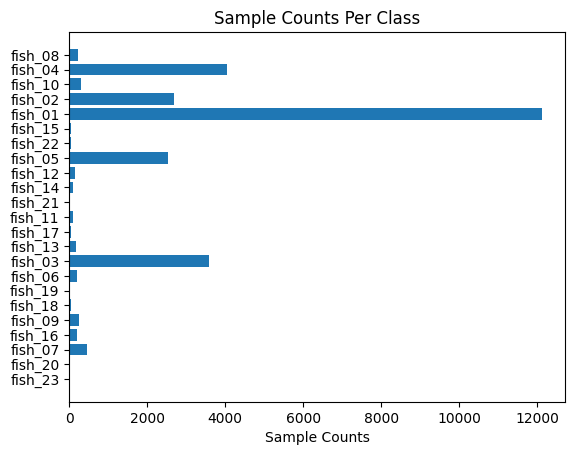

In [ ]:
classes= []
sample_counts= []

for f in os.listdir(full_set):
    train_class_path= os.path.join(full_set, f)
    if os.path.isdir(train_class_path):
        classes.append(f)
        sample_counts.append(len(os.listdir(train_class_path)))

plt.rcdefaults()
fig, ax = plt.subplots()

# Example data
y_pos = np.arange(len(classes))

ax.barh(y_pos, sample_counts, align='center')
ax.set_yticks(y_pos)
ax.set_yticklabels(classes)
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Sample Counts')
ax.set_title('Sample Counts Per Class')

plt.show()

Visualize Random images from each of the classes

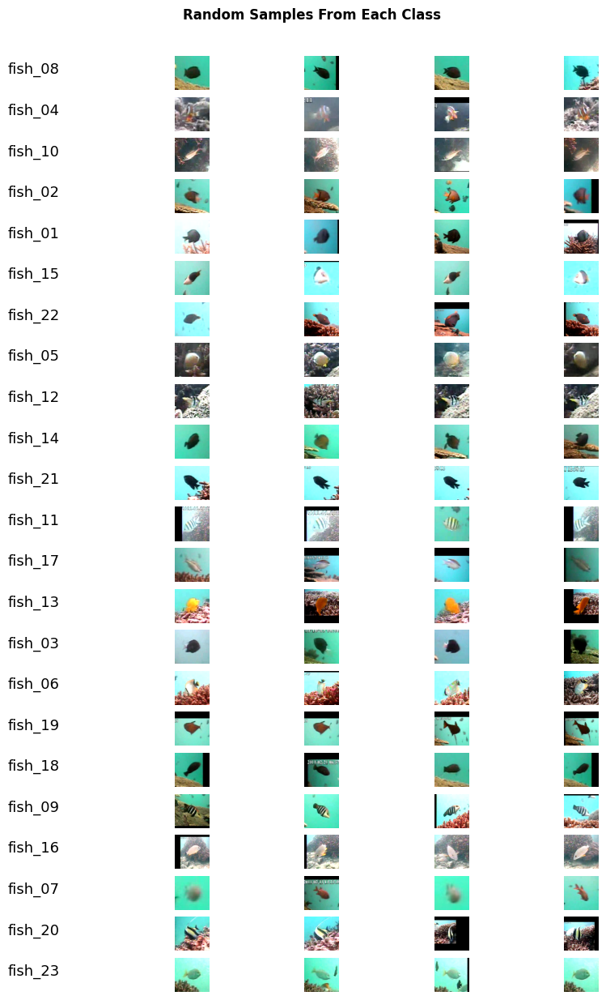

In [ ]:
fig= plt.figure(figsize= (10, 15))
fig.suptitle('Random Samples From Each Class', fontsize=12, y=.92, horizontalalignment='center', weight='bold')

columns = 5
rows = 23
for i in range(23):
    sample_class= os.path.join(full_set,classes[i])
    for j in range(1,6):
        fig.add_subplot(rows, columns, i*5+j)
        plt.axis('off')
        if j==1:
            plt.text(0.0, 0.5,str(classes[i]).replace(' ','\n'), fontsize=13, wrap=True)
            continue
        random_image= os.path.join(sample_class, random.choice(os.listdir(sample_class)))
        #from keras.preprocessing.image
        img = image.load_img(random_image, target_size=(150, 150))
        img= image.img_to_array(img)
        img/=255.
        plt.imshow(img)

plt.show()

 Create validation dataset from 10% of the training dataset

In [ ]:
def create_validation(validation_split=0.1):
    if os.path.isdir(validation_set):
        print('Validation directory already created!')
        print('Process Terminated')
        return
    os.mkdir(validation_set)
    for f in os.listdir(training_set):
        train_class_path= os.path.join(training_set, f)
        if os.path.isdir(train_class_path):
            validation_class_path= os.path.join(validation_set, f)
            os.mkdir(validation_class_path)
            files_to_move= int(0.1*len(os.listdir(train_class_path)))
            
            for i in range(files_to_move):
                random_image= os.path.join(train_class_path, random.choice(os.listdir(train_class_path)))
                shutil.move(random_image, validation_class_path)
    print('Validation set created successfully using {:.2%} of training data'.format(validation_split))
create_validation()

Validation set created successfully using 10.00% of training data


Check the sample size distribution after the split

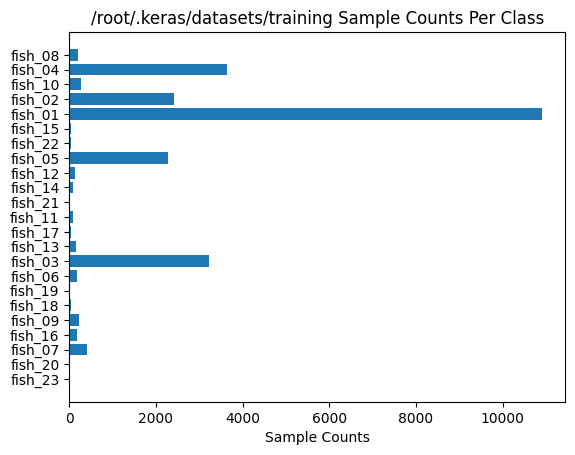

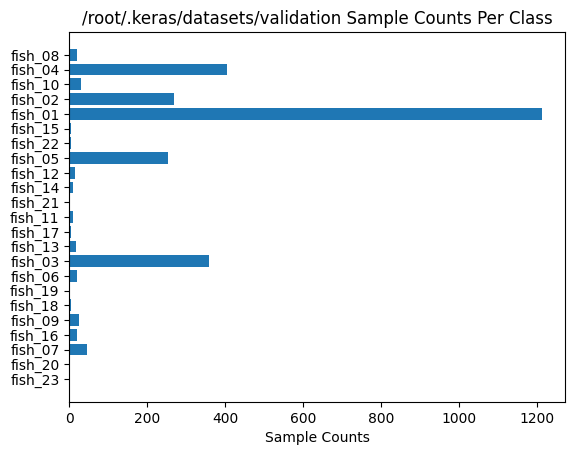

In [ ]:
sample_counts= {}

for i, d in enumerate([training_set, validation_set]):

    classes= []
    sample_counts[d]= []

    for f in os.listdir(d):
        train_class_path= os.path.join(d, f)
        if os.path.isdir(train_class_path):
            classes.append(f)
            sample_counts[d].append(len(os.listdir(train_class_path)))

    fig, ax = plt.subplots()

    # Example data
    y_pos = np.arange(len(classes))

    ax.barh(y_pos, sample_counts[d], align='center')
    ax.set_yticks(y_pos)
    ax.set_yticklabels(classes)
    ax.invert_yaxis()  # labels read top-to-bottom
    ax.set_xlabel('Sample Counts')
    ax.set_title('{} Sample Counts Per Class'.format(d.capitalize()))

plt.show()

Both the training set and the validation set are highly imbalanced.

Visualize the directory structure

In [ ]:
def print_bold(text):
    print('\033[1m{}\033[0m'.format(text))

def list_files(startpath):
    for root, dirs, files in os.walk(startpath):
        level = root.replace(startpath, '').count(os.sep)
        indent = ' ' * 4 * (level)
        
        dir_name= '{}{}/'.format(indent, os.path.basename(root))
        if dir_name.strip().startswith('.'):
            continue
        
        print_bold('\n'+dir_name)
            
        subindent = ' ' * 4 * (level + 1)
        if level==0:
            for f in files:
                if f.startswith('.'):
                    continue
                print('{}{}'.format(subindent, f))
        else:
            for i, f in enumerate(files):
                print('{}{}'.format(subindent, f))
                if i==2:
                    print('{}{}'.format(subindent, '...'))
                    break

list_files(spath)


/
    fish.tar.gz
    masks.tar.gz

training/

    fish_08/
        fish_000013890001_01465.png
        fish_000040059596_04366.png
        fish_000038109596_04314.png
        ...

    fish_04/
        fish_004237396932_18847.png
        fish_003823746136_09076.png
        fish_000014989599_08499.png
        ...

    fish_10/
        fish_003478805350_11902.png
        fish_004402137135_13569.png
        fish_003953286451_13032.png
        ...

    fish_02/
        fish_000069119596_04920.png
        fish_455992738602_12200.png
        fish_004148316796_23493.png
        ...

    fish_01/
        fish_000102369598_06942.png
        fish_004568167401_20081.png
        fish_004544477366_22576.png
        ...

    fish_15/
        fish_002199000115_01918.png
        fish_003486885364_11243.png
        fish_003486885364_11244.png
        ...

    fish_22/
        fish_000021760001_01811.png
        fish_000021820001_01835.png
        fish_000021760001_01813.png
        ...

    fish_05/
 

**Setting some variables**

Batch size of 32; so 32 samples to propagate through the network

In [ ]:
# initializing some variables

batch_size = 32
img_height = 180
img_width = 180

**Setup Training and Validation datasets. Use 10% of the data for validation**

In [ ]:
# training set

training_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    training_set,
    labels="inferred",
    label_mode="int",
    seed = 123,
    image_size = (img_height,img_width),
    batch_size  = batch_size
)

Found 24643 files belonging to 23 classes.


In [ ]:
# validation set

validation_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    validation_set,
    labels="inferred",
    label_mode="int",
    seed = 123,
    image_size = (img_height,img_width),
    batch_size  = batch_size
)

Found 2727 files belonging to 23 classes.


In [ ]:
class_names = training_dataset.class_names
print(class_names)

['fish_01', 'fish_02', 'fish_03', 'fish_04', 'fish_05', 'fish_06', 'fish_07', 'fish_08', 'fish_09', 'fish_10', 'fish_11', 'fish_12', 'fish_13', 'fish_14', 'fish_15', 'fish_16', 'fish_17', 'fish_18', 'fish_19', 'fish_20', 'fish_21', 'fish_22', 'fish_23']


**Visualize random images from the classes**

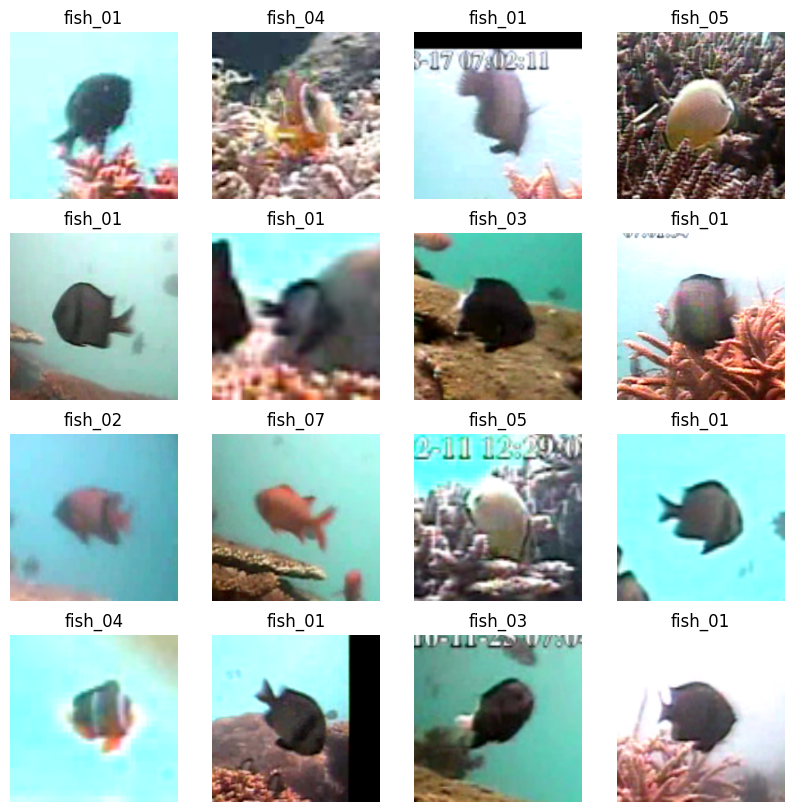

In [ ]:
plt.figure(figsize=(10,10))
for images, labels in training_dataset.take(1):
  for i in range(16):
    ax = plt.subplot(4,4,i+1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [ ]:
for image_batch, labels_batch in training_dataset:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 180, 180, 3)
(32,)


In [ ]:
AUTOTUNE = tf.data.experimental.AUTOTUNE
training_dataset = training_dataset.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
validation_dataset = validation_dataset.cache().prefetch(buffer_size=AUTOTUNE)

**Stardardize the data to zero & one from RGB format 0 - 255**

In [ ]:
normalization_layer = layers.experimental.preprocessing.Rescaling(1./255)

In [ ]:
normalized_ds = training_dataset.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
print(np.min(first_image),np.max(first_image))

0.0 1.0


**Create the Classification Model, using adam optimizer**

In [ ]:
num_classes = 23

model = Sequential([
                    layers.experimental.preprocessing.Rescaling(1./255, input_shape = (img_height, img_width, 3)),
                    layers.Conv2D(16, 3, padding='same', activation='relu'),
                    layers.MaxPooling2D(),
                    layers.Conv2D(32, 3, padding='same', activation='relu'),
                    layers.MaxPooling2D(),
                    layers.Conv2D(64, 3, padding='same', activation='relu'),
                    layers.MaxPooling2D(),
                    layers.Flatten(),
                    layers.Dense(128, activation='relu'),
                    layers.Dense(num_classes),
                    ])

In [ ]:
opt= keras.optimizers.Adam(learning_rate=0.0005,amsgrad=True)
model.compile(optimizer=opt, loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_1 (Rescaling)      (None, 180, 180, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 180, 180, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 90, 90, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 90, 90, 32)        4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 45, 45, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 45, 45, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 22, 22, 64)        0

**Train the model**

Create a callback that saves the model's weights

In [ ]:
checkpoint_loc = "training_checkpoints/cp-ini-{epoch:04d}.ckpt"
checkpoint_dir = os.path.dirname(checkpoint_loc)
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_dir,save_weights_only=True,verbose=1)

Initial test, running 10 epochs. No data augmentation applied at this point.

In [ ]:
epochs = 10
history = model.fit(training_dataset,validation_data=validation_dataset,epochs=epochs,callbacks=[cp_callback])

Epoch 1/10
771/771 [==============================] - 793s 1s/step - loss: 0.0844 - accuracy: 0.9745 - val_loss: 0.1123 - val_accuracy: 0.9648

Epoch 00001: saving model to training_checkpoints
Epoch 2/10
771/771 [==============================] - 771s 1000ms/step - loss: 0.0494 - accuracy: 0.9854 - val_loss: 0.1181 - val_accuracy: 0.9633

Epoch 00002: saving model to training_checkpoints
Epoch 3/10
771/771 [==============================] - 767s 995ms/step - loss: 0.0299 - accuracy: 0.9914 - val_loss: 0.0721 - val_accuracy: 0.9831

Epoch 00003: saving model to training_checkpoints
Epoch 4/10
771/771 [==============================] - 764s 991ms/step - loss: 0.0177 - accuracy: 0.9948 - val_loss: 0.0773 - val_accuracy: 0.9820

Epoch 00004: saving model to training_checkpoints
Epoch 5/10
771/771 [==============================] - 756s 980ms/step - loss: 0.0145 - accuracy: 0.9961 - val_loss: 0.1296 - val_accuracy: 0.9718

Epoch 00005: saving model to training_checkpoints
Epoch 6/10
771/77

In [ ]:
# saving the model

!mkdir -p trained_models
model.save('trained_model/initial_run')

INFO:tensorflow:Assets written to: trained_model/initial_run/assets


**Visualize the result of the training**

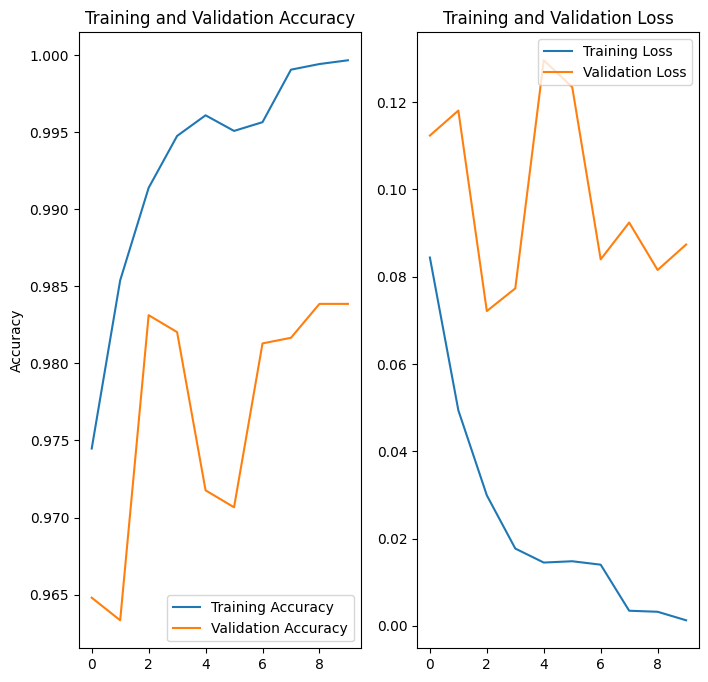

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8,8))
plt.subplot(1,2,1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')

plt.subplot(1,2,2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')

plt.show()


**Weighting**

Adding weighting to add some balance to the huge class imbalance. Ideally the classes with higher sample sizes get lower weights so that the model understands that more attention should be applied to the classes with fewer samples.

In [ ]:
class_weights={}
samples = {}

species_directory = os.listdir(training_set)

for species in species_directory:
  species_path = os.path.join(training_set,species)
  sameples_per_species = 0
  for acfilename in os.listdir(species_path):
    sameples_per_species += 1
  samples[species] = 1.0/sameples_per_species

norm_factor= np.mean(list(samples.values()))

for key, value in samples.items():
  cnamint = int(key.replace("fish_",""))-1
  class_weights[cnamint] = value/norm_factor

print(class_weights)

t = PrettyTable(['class_index', 'class_weights'])
for i in sorted(class_weights.keys()):
    t.add_row([i, '{:.2f}'.format(class_weights[i])])
print(t)

{7: 0.32356202963669567, 3: 0.01748744028489137, 9: 0.23608044384603352, 1: 0.026394086889618654, 0: 0.005847327753273007, 14: 1.6774136799586592, 21: 1.7227491848224068, 4: 0.027944638245694455, 11: 0.47926105141675973, 13: 0.7869348128201117, 20: 4.249447989228603, 10: 0.7161990993081916, 16: 1.416482663076201, 12: 0.3910534959412825, 2: 0.019709870079910034, 5: 0.3727585955463687, 18: 2.360804438460335, 17: 1.2498376438907657, 8: 0.2937406444167237, 15: 0.34269741848617774, 6: 0.15738696256402235, 19: 3.3548273599173184, 22: 2.7713791234099587}
+-------------+---------------+
| class_index | class_weights |
+-------------+---------------+
|      0      |      0.01     |
|      1      |      0.03     |
|      2      |      0.02     |
|      3      |      0.02     |
|      4      |      0.03     |
|      5      |      0.37     |
|      6      |      0.16     |
|      7      |      0.32     |
|      8      |      0.29     |
|      9      |      0.24     |
|      10     |      0.72     

**Attempts at Data Augmentation - Flipping, rotation and zoom**

The goal of data augmentation is to get rid of overfitting seen in the initial training result

Addition of random flipping, rotation and zooming. We went with horizontal flipping, vertical flips saw a drop on accuracy.

In [ ]:
data_augmentation = keras.Sequential(
    [
     layers.experimental.preprocessing.RandomFlip("horizontal", input_shape=(img_height,img_width,3)),
     layers.experimental.preprocessing.RandomRotation(0.1),
     layers.experimental.preprocessing.RandomZoom(0.1),
    ]
)

Present visualization of what you would expect from this. You will note that horizontal flipping makes more sense for this scenario based on the dimensions or "shape" of fish.

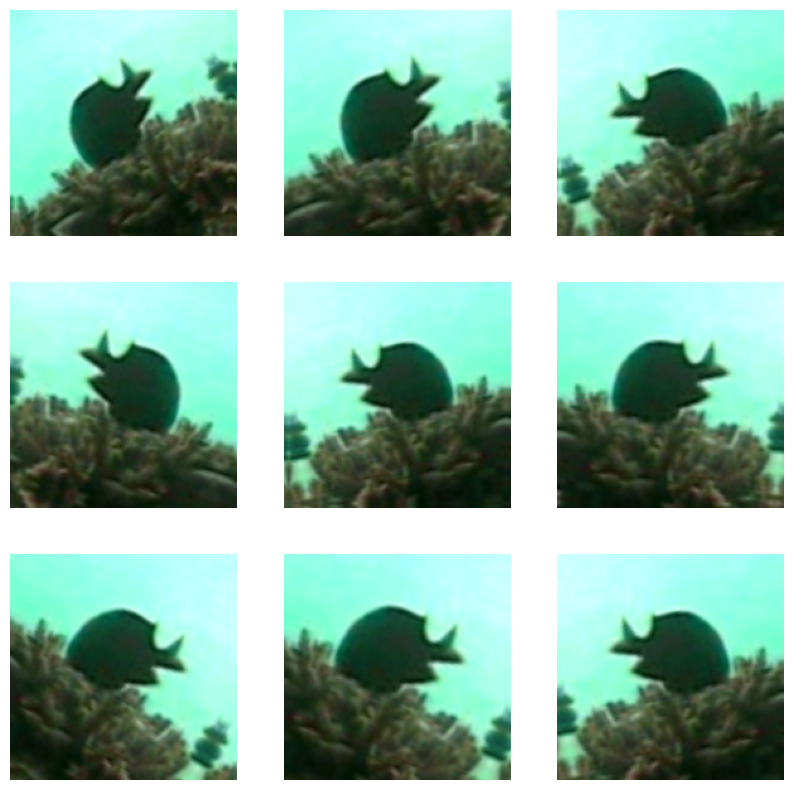

In [ ]:
plt.figure(figsize=(10,10))
for images, _ in training_dataset.take(1):
  for i in range(9):
    augmented_images = data_augmentation(images)
    ax = plt.subplot(3,3,i+1)
    plt.imshow(augmented_images[0].numpy().astype("uint8"))
    plt.axis("off")

**Apply augmentation to the model**

In [ ]:
aug_model = Sequential([
  data_augmentation,

  layers.experimental.preprocessing.Rescaling(1./255),

  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(2,2),
  layers.Dropout(0.2),

  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(2,2),
  layers.Dropout(0.2),

  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(2,2),
  layers.Dropout(0.2),

  layers.Conv2D(128, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(2,2),
  layers.Dropout(0.2),

  layers.Flatten(),
  layers.Dropout(0.4),
  layers.Dense(256, activation='relu'),
  layers.Dropout(0.4),
  
  layers.Dense(num_classes)
])

Using Adam optimizer

In [ ]:
opt= keras.optimizers.Adam(learning_rate=0.0005,amsgrad=True)
aug_model.compile(optimizer=opt, loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),metrics=['accuracy'])

In [ ]:
aug_model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential_1 (Sequential)    (None, 180, 180, 3)       0         
_________________________________________________________________
rescaling_2 (Rescaling)      (None, 180, 180, 3)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 180, 180, 16)      448       
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 90, 90, 16)        0         
_________________________________________________________________
dropout (Dropout)            (None, 90, 90, 16)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 90, 90, 32)        4640      
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 45, 45, 32)       

Second run

In [ ]:
#checkpoint_loc_final = "training_checkpoints/cp-aug-{epoch:04d}.ckpt"
#checkpoint_dir_final = os.path.dirname(checkpoint_loc_final)
#fina_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_dir_final,save_weights_only=True,verbose=1)

best_cb= callbacks.ModelCheckpoint('model_best.h5', 
                                         monitor='val_loss', 
                                         verbose=1, 
                                         save_best_only=True, 
                                         save_weights_only=False, 
                                         mode='auto')


In [ ]:
epochs = 15
#aug_history = aug_model.fit(training_dataset,validation_data=validation_dataset,steps_per_epoch= 190,epochs=epochs,class_weight=class_weights,callbacks=[fina_callback])

aug_history = aug_model.fit(
                    training_dataset,
                    class_weight= class_weights,
                    epochs=epochs,
                    validation_data=validation_dataset,
                    verbose=1,
                    callbacks= [best_cb])


Instructions for updating:
The `validate_indices` argument has no effect. Indices are always validated on CPU and never validated on GPU.
Epoch 1/15
771/771 [==============================] - 952s 1s/step - loss: 0.1597 - accuracy: 0.2496 - val_loss: 2.0813 - val_accuracy: 0.3799

Epoch 00001: val_loss improved from inf to 2.08131, saving model to model_best.h5
Epoch 2/15
771/771 [==============================] - 942s 1s/step - loss: 0.1139 - accuracy: 0.3859 - val_loss: 1.5988 - val_accuracy: 0.4994

Epoch 00002: val_loss improved from 2.08131 to 1.59883, saving model to model_best.h5
Epoch 3/15
771/771 [==============================] - 939s 1s/step - loss: 0.0909 - accuracy: 0.4754 - val_loss: 1.0984 - val_accuracy: 0.6164

Epoch 00003: val_loss improved from 1.59883 to 1.09844, saving model to model_best.h5
Epoch 4/15
771/771 [==============================] - 937s 1s/step - loss: 0.0786 - accuracy: 0.4950 - val_loss: 1.3151 - val_accuracy: 0.5501

Epoch 00004: val_loss did not im

In [ ]:
#load best model from training
from keras.models import load_model
aug_model = load_model('model_best.h5')
#aug_model= aug_model.load_model('model_best.h5')

In [ ]:
# convert the history.history dict to a pandas DataFrame:     
hist_df = pd.DataFrame(aug_history.history) 

# save to csv: 
hist_csv_file = 'history.csv'
with open(hist_csv_file, mode='w') as f:
    hist_df.to_csv(f)

**Generate the Results of the Training after Data Augmentation**

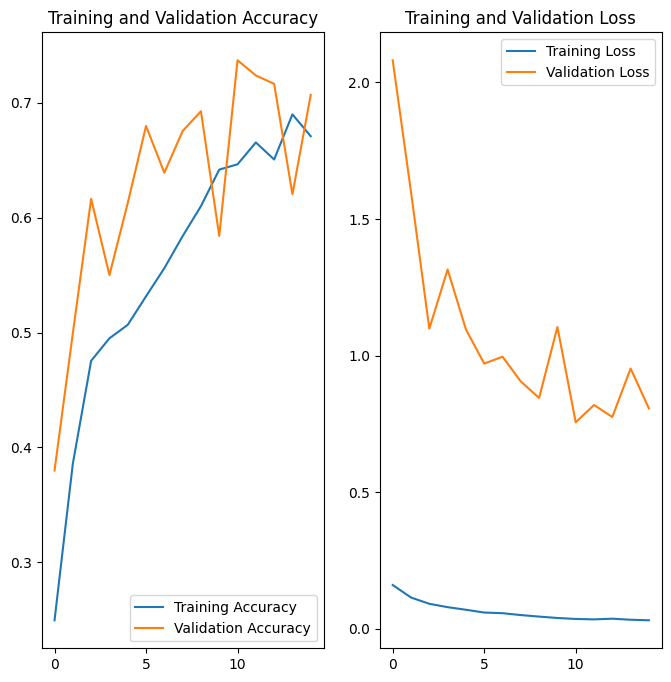

In [ ]:
acc = aug_history.history['accuracy']
val_acc = aug_history.history['val_accuracy']

loss = aug_history.history['loss']
val_loss = aug_history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8,8))
plt.subplot(1,2,1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1,2,2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')

plt.show()

Test the results, run some predictions

In [ ]:
testfish = "/root/.keras/datasets/validation/fish_08/fish_000026380001_02573.png"

img = keras.preprocessing.image.load_img(
    testfish, target_size = (img_height,img_width)
)

img_array = keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)

predictions = aug_model.predict(img_array)
score = tf.nn.softmax(predictions[0])

print(
    "This fish is of class {} with a {:.2f} percent confidence."
    .format(class_names[np.argmax(score)],100 * np.max(score))
)

This fish is of class fish_08 with a 68.27 percent confidence.


In [ ]:
testfish = "/root/.keras/datasets/validation/fish_21/fish_000023860001_02337.png"

img = keras.preprocessing.image.load_img(
    testfish, target_size = (img_height,img_width)
)

img_array = keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)

predictions = aug_model.predict(img_array)
score = tf.nn.softmax(predictions[0])

print(
    "This fish is of class {} with a {:.2f} percent confidence."
    .format(class_names[np.argmax(score)],100 * np.max(score))
)

This fish is of class fish_21 with a 94.93 percent confidence.


In [ ]:
testfish = "/root/.keras/datasets/validation/fish_23/fish_000007060001_00793.png"

img = keras.preprocessing.image.load_img(
    testfish, target_size = (img_height,img_width)
)

img_array = keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)

predictions = aug_model.predict(img_array)
score = tf.nn.softmax(predictions[0])

print(
    "This fish is of class {} with a {:.2f} percent confidence."
    .format(class_names[np.argmax(score)],100 * np.max(score))
)

This fish is of class fish_23 with a 99.71 percent confidence.


### Model Evaluation

#### Precision, Accuracy and F1 score

In [ ]:
!pip install split-folders

In [ ]:
parent_dir = '/content/drive/MyDrive/fish/'

split = 'split'

In [ ]:
path = os.path.join(parent_dir, split)
os.mkdir(path)

In [ ]:
# input = 
output = "/content/drive/MyDrive/fish/split"

In [ ]:
import splitfolders  # or import split_folders

# Split with a ratio.
# To only split into training and validation set, set a tuple to `ratio`, i.e, `(.8, .2)`.
# splitfolders.ratio(data_dir, output= output, seed=1337, ratio=(.9, .1), group_prefix=None) # default values

Copying files: 27370 files [03:50, 118.97 files/s]


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# path to both folders

train_path = '/content/drive/MyDrive/fish/split/train'
valid_path = '/content/drive/MyDrive/fish/split/val'

train_path = pathlib.Path(train_path)
valid_path = pathlib.Path(valid_path)

In [ ]:
# number of images in the validation set
num_val_samples = len(list(valid_path.glob('*/*')))
print(num_val_samples)

2747


In [ ]:
# number of images in the train set
num_train_samples = len(list(train_path.glob('*/*')))
print(num_train_samples)


24623


In [ ]:
# setting up generators
train_batch_size = 32
val_batch_size = 32
IMAGE_SIZE = 180

train_steps = np.ceil(num_train_samples / train_batch_size)
val_steps = np.ceil(num_val_samples / val_batch_size)

In [ ]:
datagen = ImageDataGenerator(rescale=1.0/255)

train_gen = datagen.flow_from_directory(train_path,
                                        target_size=(IMAGE_SIZE,IMAGE_SIZE),
                                        batch_size=train_batch_size,
                                        class_mode='categorical')

val_gen = datagen.flow_from_directory(valid_path,
                                        target_size=(IMAGE_SIZE,IMAGE_SIZE),
                                        batch_size=val_batch_size,
                                        class_mode='categorical')

Found 24623 images belonging to 23 classes.
Found 2747 images belonging to 23 classes.


In [ ]:
class_weights={}
samples = {}

species_directory = os.listdir(train_path)

for species in species_directory:
  species_path = os.path.join(train_path,species)
  sameples_per_species = 0
  for acfilename in os.listdir(species_path):
    sameples_per_species += 1
  samples[species] = 1.0/sameples_per_species

norm_factor= np.mean(list(samples.values()))

for key, value in samples.items():
  cnamint = int(key.replace("fish_",""))-1
  class_weights[cnamint] = value/norm_factor

print(class_weights)

t = PrettyTable(['class_index', 'class_weights'])
for i in sorted(class_weights.keys()):
    t.add_row([i, '{:.2f}'.format(class_weights[i])])
print(t)

{7: 0.31326754087739994, 3: 0.01684973600767574, 9: 0.2282544164013769, 1: 0.025435144164030813, 0: 0.005633067707520219, 14: 1.6594712976208215, 21: 1.705567722554733, 4: 0.02693001667191684, 11: 0.4651548334240181, 13: 0.7580300989132146, 20: 4.385745572283599, 10: 0.6977322501360271, 16: 1.3954645002720543, 12: 0.3790150494566073, 2: 0.018991784105156322, 5: 0.35906688895889116, 18: 2.3615553081527074, 17: 1.2280087602394079, 8: 0.2842612870924555, 15: 0.3318942595241643, 6: 0.15160601978264293, 19: 3.411135445109466, 22: 2.7909290005441085}
+-------------+---------------+
| class_index | class_weights |
+-------------+---------------+
|      0      |      0.01     |
|      1      |      0.03     |
|      2      |      0.02     |
|      3      |      0.02     |
|      4      |      0.03     |
|      5      |      0.36     |
|      6      |      0.15     |
|      7      |      0.31     |
|      8      |      0.28     |
|      9      |      0.23     |
|      10     |      0.70     |
|

In [ ]:
data_augmentation = keras.Sequential(
    [
     layers.experimental.preprocessing.RandomFlip("horizontal", input_shape=(IMAGE_SIZE,IMAGE_SIZE,3)),
     layers.experimental.preprocessing.RandomRotation(0.1),
     layers.experimental.preprocessing.RandomZoom(0.1),
    ]
)

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

# Clear any logs from previous runs
!rm -rf ./logs/ 

In [ ]:
num_classes = 23

In [ ]:
NAME = 'Weighted Model'     # naming our baseline model
tensorboard_callback = TensorBoard(log_dir="logs/fit/{}".format(NAME))
print(NAME)

aug_model = Sequential([
  data_augmentation,

  # layers.experimental.preprocessing.Rescaling(1./255),

  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(2,2),
  layers.Dropout(0.2),

  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(2,2),
  layers.Dropout(0.2),

  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(2,2),
  layers.Dropout(0.2),

  layers.Conv2D(128, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(2,2),
  layers.Dropout(0.2),

  layers.Flatten(),
  layers.Dropout(0.4),
  layers.Dense(256, activation='relu'),
  layers.Dropout(0.4),
  
  layers.Dense(num_classes, activation = 'softmax')
])

Weighted Model


### Train the Model

In [ ]:
# opt= keras.optimizers.Adam(learning_rate=0.0005,amsgrad=True)
# aug_model.compile(optimizer=opt, loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),metrics=['accuracy']) 

aug_model.compile(Adam(lr=0.0001), loss='categorical_crossentropy', 
              metrics=['accuracy'])

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


In [ ]:
# Get the labels that are associated with each index
print(val_gen.class_indices)

{'fish_01': 0, 'fish_02': 1, 'fish_03': 2, 'fish_04': 3, 'fish_05': 4, 'fish_06': 5, 'fish_07': 6, 'fish_08': 7, 'fish_09': 8, 'fish_10': 9, 'fish_11': 10, 'fish_12': 11, 'fish_13': 12, 'fish_14': 13, 'fish_15': 14, 'fish_16': 15, 'fish_17': 16, 'fish_18': 17, 'fish_19': 18, 'fish_20': 19, 'fish_21': 20, 'fish_22': 21, 'fish_23': 22}


In [ ]:
best_cb= callbacks.ModelCheckpoint('model_best.h5', 
                                         monitor='val_loss', 
                                         verbose=1, 
                                         save_best_only=True, 
                                         save_weights_only=True, 
                                         mode='auto')

In [ ]:
history2 = aug_model.fit_generator(train_gen, 
                                   steps_per_epoch=train_steps, 
                                   validation_data=val_gen,
                                   validation_steps=val_steps,
                                  class_weight= class_weights,
                                   epochs=15,
                                   verbose=1,
                                  callbacks=[best_cb])

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1940: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Instructions for updating:
The `validate_indices` argument has no effect. Indices are always validated on CPU and never validated on GPU.
Epoch 1/15
770/770 [==============================] - 8305s 11s/step - loss: 0.1661 - accuracy: 0.1698 - val_loss: 2.5014 - val_accuracy: 0.2577

Epoch 00001: val_loss improved from inf to 2.50142, saving model to model_best.h5
Epoch 2/15
770/770 [==============================] - 66s 86ms/step - loss: 0.1285 - accuracy: 0.3076 - val_loss: 2.0559 - val_accuracy: 0.3542

Epoch 00002: val_loss improved from 2.50142 to 2.05593, saving model to model_best.h5
Epoch 3/15
770/770 [==============================] - 65s 85ms/step - loss: 0.1093 - accuracy: 0.3727 - val_loss: 1.8972 - val_accuracy: 0.5129

Epoch 00003: val_loss improved from 2.05593 to 1.89725, saving model to model_best.h5
Epoch 4/15
770/770 [==============================] - 66s 85ms/step - loss: 0.0958 - accuracy: 0.4208 - val_loss: 1.6836 - val_accuracy: 0.4951

Epoch 00004: val_loss impro

In [ ]:
# get the metric names so we can use evaulate_generator
aug_model.metrics_names

['loss', 'accuracy']

In [ ]:
# Here the best epoch will be used.

aug_model.load_weights('/content/model_best.h5')

val_loss, val_acc = \
aug_model.evaluate_generator(val_gen, 
                        steps=num_val_samples)

print('val_loss:', val_loss)
print('val_acc:', val_acc)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


val_loss: 0.7851030230522156
val_acc: 0.764106273651123


In [ ]:
# make a prediction
predictions = aug_model.predict_generator(val_gen, steps=num_val_samples, verbose=1)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:2001: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


2747/2747 [==============================] - 6s 2ms/step


In [ ]:
# size of the predictions
predictions.shape

(2747, 23)

In [ ]:
# put the predictions into a dataframe
# first check the labels keras has assigned the classes
val_gen.class_indices

{'fish_01': 0,
 'fish_02': 1,
 'fish_03': 2,
 'fish_04': 3,
 'fish_05': 4,
 'fish_06': 5,
 'fish_07': 6,
 'fish_08': 7,
 'fish_09': 8,
 'fish_10': 9,
 'fish_11': 10,
 'fish_12': 11,
 'fish_13': 12,
 'fish_14': 13,
 'fish_15': 14,
 'fish_16': 15,
 'fish_17': 16,
 'fish_18': 17,
 'fish_19': 18,
 'fish_20': 19,
 'fish_21': 20,
 'fish_22': 21,
 'fish_23': 22}

In [ ]:
# create dataframe with the respective labels
df_preds = pd.DataFrame(predictions)

df_preds.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22
0,0.331327,0.011088,0.050105,0.011777,0.007185,0.016276,0.005356,0.080240,0.101191,0.003955,0.033127,0.070536,0.002865,0.015821,0.006999,0.004761,0.193099,0.006027,0.003346,0.008718,0.015204,0.013796,0.007199
1,0.042426,0.053794,0.499776,0.005345,0.000042,0.000081,0.000196,0.016357,0.000392,0.000163,0.000040,0.000053,0.004154,0.357657,0.003182,0.000008,0.000149,0.002270,0.001844,0.000154,0.010688,0.001225,0.000004
2,0.012444,0.235148,0.032976,0.000770,0.001651,0.001164,0.000450,0.018957,0.010913,0.000061,0.000052,0.000146,0.003816,0.610493,0.006414,0.000009,0.000139,0.002498,0.058448,0.000061,0.002263,0.001047,0.000081
3,0.041750,0.356009,0.069105,0.071757,0.007544,0.001670,0.106265,0.029203,0.009223,0.075628,0.007386,0.009706,0.014820,0.019912,0.016030,0.039751,0.020337,0.012011,0.006718,0.009076,0.008325,0.067498,0.000276
4,0.053672,0.001407,0.857498,0.000147,0.000016,0.000090,0.000015,0.026655,0.001360,0.000016,0.000065,0.000953,0.000027,0.034864,0.000609,0.000001,0.000591,0.001342,0.000099,0.000035,0.020311,0.000202,0.000023


In [ ]:
# Get the true labels
y_true = val_gen.classes
y_true


array([ 0,  0,  0, ..., 22, 22, 22], dtype=int32)

In [ ]:
len(y_true)

2747

In [ ]:
# Get the predicted labels as probabilities
y_pred = df_preds[[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]]
# y_pred

#### Classification Report

In [ ]:

# Generate a classification report

# For this to work we need y_pred as binary labels not as probabilities
y_pred_binary = predictions.argmax(axis=1)

report = classification_report(y_true, y_pred_binary, target_names= ['fish_01', 'fish_02', 'fish_03', 'fish_04', 'fish_05', 
                                                                     'fish_06', 'fish_07', 'fish_08', 'fish_09', 'fish_10',
                                                                     'fish_11','fish_12', 'fish_13', 'fish_14', 'fish_15',
                                                                     'fish_16','fish_17', 'fish_18', 'fish_19', 'fish_20',
                                                                     'fish_21','fish_22', 'fish_23'])

print(report)

              precision    recall  f1-score   support

     fish_01       0.43      0.25      0.31      1212
     fish_02       0.11      0.12      0.11       269
     fish_03       0.15      0.23      0.19       360
     fish_04       0.13      0.13      0.13       405
     fish_05       0.08      0.07      0.08       254
     fish_06       0.00      0.00      0.00        19
     fish_07       0.02      0.02      0.02        45
     fish_08       0.00      0.00      0.00        22
     fish_09       0.00      0.00      0.00        25
     fish_10       0.00      0.00      0.00        30
     fish_11       0.00      0.00      0.00        10
     fish_12       0.00      0.00      0.00        15
     fish_13       0.00      0.00      0.00        19
     fish_14       0.00      0.00      0.00         9
     fish_15       0.00      0.00      0.00         5
     fish_16       0.00      0.00      0.00        21
     fish_17       0.00      0.00      0.00         5
     fish_18       0.00    




*   Recall - Computes a batchwise average of recall. Tells us how many relevant items are selected. Given a class, will the classifier be able to detect it?

*   Precision - Predicts a batch-wise average of precision. This gives us a percentage of how many selected items are relevant. Given a class prediction from a classifier, how likely is it to be correct?

*   The harmonic mean of precision and recall. Essentially, it punishes extreeme values



### Obtaining the tensorboard

In [ ]:
 %tensorboard --logdir logs/fit


<IPython.core.display.Javascript object>

### Visualizing Feature Maps

In [ ]:
# summarize feature map shapes
for i in range(len(aug_model.layers)):
	layer = aug_model.layers[i]
	# check for convolutional layer
	if 'conv' not in layer.name:
		continue
	# summarize output shape
	print(i, layer.name, layer.output.shape)
# 

1 conv2d (None, 180, 180, 16)
4 conv2d_1 (None, 90, 90, 32)
7 conv2d_2 (None, 45, 45, 64)
10 conv2d_3 (None, 22, 22, 128)


In [ ]:
layer_names = [layer.name for layer in aug_model.layers]
layer_names

# checking the layers
aug_model.layers

# getting output of the layers of cnn
layer_outputs = [layer.output for layer in aug_model.layers]

In [ ]:
# redefine model to output right after the first hidden layer
# feature map visualization
# feature map visualization
feature_map_model = tf.keras.models.Model(inputs=aug_model.input, outputs=layer_outputs)

#### Load example image 

In [ ]:
# create directory with test images
for folder in os.listdir(data_dir):
  path_name = os.path.join(data_dir, folder)
  print(path_name)

/root/.keras/datasets/fish/fish_14
/root/.keras/datasets/fish/fish_17
/root/.keras/datasets/fish/fish_11
/root/.keras/datasets/fish/fish_01
/root/.keras/datasets/fish/fish_10
/root/.keras/datasets/fish/fish_15
/root/.keras/datasets/fish/fish_09
/root/.keras/datasets/fish/fish_18
/root/.keras/datasets/fish/fish_16
/root/.keras/datasets/fish/fish_23
/root/.keras/datasets/fish/fish_20
/root/.keras/datasets/fish/fish_19
/root/.keras/datasets/fish/fish_06
/root/.keras/datasets/fish/fish_12
/root/.keras/datasets/fish/fish_07
/root/.keras/datasets/fish/fish_22
/root/.keras/datasets/fish/fish_13
/root/.keras/datasets/fish/fish_02
/root/.keras/datasets/fish/fish_21
/root/.keras/datasets/fish/fish_04
/root/.keras/datasets/fish/fish_03
/root/.keras/datasets/fish/fish_08
/root/.keras/datasets/fish/fish_05


In [ ]:
# os.listdir('/root/.keras/datasets/fish/fish_13')

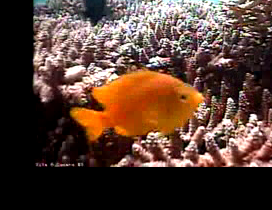

In [ ]:
# load image to use

test_image = cv2.imread('/root/.keras/datasets/fish/fish_13/fish_000007729597_05100.png')
cv2_imshow(test_image)

In [ ]:
# preprocessing the image

test_image  = cv2.resize(test_image, (IMG_SIZE, IMG_SIZE))
test_image = np.asarray(test_image)

input = test_image.reshape((1,) + test_image.shape)                   
input = input /255

In [ ]:
feature_maps = feature_map_model.predict(input)

In [ ]:
for layer_name, feature_map in zip(layer_names, feature_maps):   
  if len(feature_map.shape) == 4:      # Number of feature images/dimensions in a feature map of a layer 
    k = feature_map.shape[-1]  
  
    #iterating over a feature map of a particular layer to separate all feature images.    
    for i in range(k):
      feature_image = feature_map[0, :, :, i]   
      feature_image-= feature_image.mean()
      feature_image/= feature_image.std ()
      feature_image*=  64
      feature_image+= 128
      feature_image= np.clip(test_image, 0, 255).astype('uint8')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in true_divide
  if __name__ == '__main__':


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


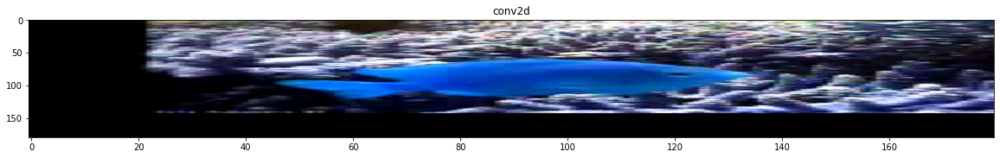

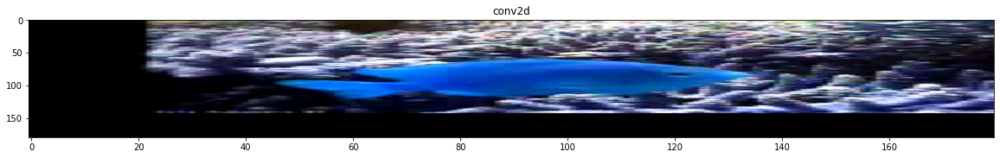

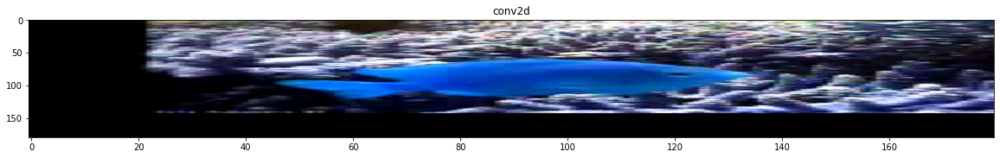

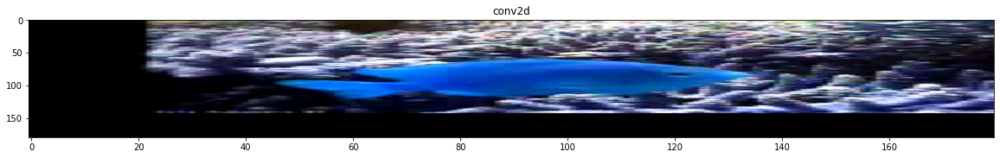

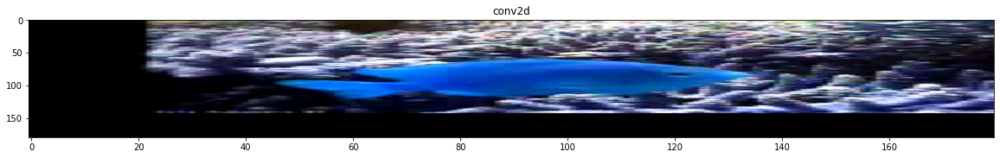

...

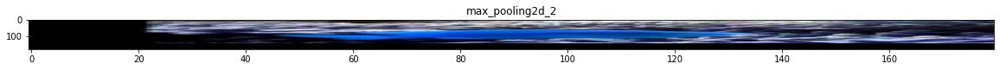

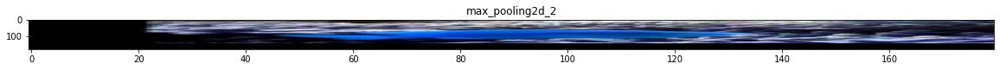

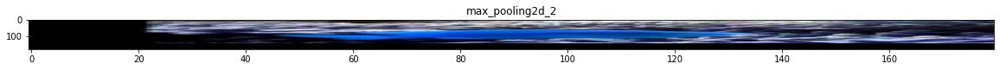

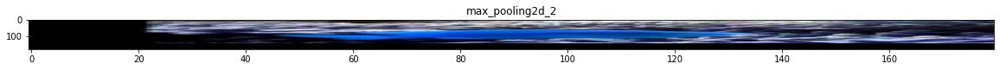

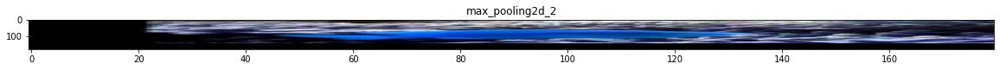

In [ ]:
for layer_name, feature_map in zip(layer_names, feature_maps): 
   if len(feature_map.shape) == 4:
      k = feature_map.shape[-1]  
      size=feature_map.shape[1]
      for i in range(k):
        feature_image = feature_map[0, :, :, i]
        feature_image-= feature_image.mean()
        feature_image/= feature_image.std ()
        feature_image*=  64
        feature_image+= 128
        feature_image= np.clip(test_image, 0, 255).astype('uint8')
        # image_belt[:, i * size : (i + 1) * size] = feature_image 
        scale = 20. / k
        plt.figure( figsize=(scale * k, scale) )
        plt.title ( layer_name )
        plt.grid  ( False )
        plt.imshow( feature_image, aspect='auto') 

## Challenging the solution

After applying weighting, augmentation and implementing a Convolution Neural Network Model, we achieved the highest accuray of approximately 70%. Which is what we hoped to accomplish. However, our recall and precision scores were relatively low as our dataset was highly imbalanced. Attempts to include the performance of the model would include:

1. Downsampling the class that is overly represented in an attempt to balance the classes.
2. Applying cross-validation to the model.
3. Increasing the complexity of the model.